In [154]:
# Import des bibliothèques

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder
import joblib

In [128]:
# Chargement des données

url = "https://raw.githubusercontent.com/louiskuhn/IA-P3-Euskadi/main/Projets/Projet%20P5%20-%20IMDB/5000_movies_bis.csv"

data = pd.read_csv(url)

1. Exploration des données

In [129]:
# Nombre de doublons

doublons =data.duplicated().sum()
print("Nombre de doublons :", doublons)

Nombre de doublons : 45


In [130]:
# Suppression des doublons

data.drop_duplicates(inplace=True)

In [131]:
# Supprimer les doublons en utilisant les colonnes spécifiées comme critères
data.drop_duplicates(subset=['movie_imdb_link', 'director_name', 'movie_title'], inplace=True)

In [132]:
# Structure des données

data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4919 entries, 0 to 5042
Data columns (total 28 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   color                   4900 non-null   object 
 1   director_name           4817 non-null   object 
 2   num_critic_for_reviews  4870 non-null   float64
 3   duration                4904 non-null   float64
 4   director_fb_likes       4817 non-null   float64
 5   actor_3_fb_likes        4896 non-null   float64
 6   actor_2_name            4906 non-null   object 
 7   actor_1_fb_likes        4912 non-null   float64
 8   gross                   4251 non-null   float64
 9   genres                  4919 non-null   object 
 10  actor_1_name            4912 non-null   object 
 11  movie_title             4919 non-null   object 
 12  num_voted_users         4919 non-null   int64  
 13  cast_total_fb_likes     4919 non-null   int64  
 14  actor_3_name            4896 non-null   objec

In [133]:
# Premières lignes

data.head(10)

,color,director_name,num_critic_for_reviews,duration,director_fb_likes,actor_3_fb_likes,actor_2_name,actor_1_fb_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_fb_likes,imdb_score,aspect_ratio,movie_fb_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0
5,Color,Andrew Stanton,462.0,132.0,475.0,530.0,Samantha Morton,640.0,73058679.0,Action|Adventure|Sci-Fi,...,738.0,English,USA,PG-13,263700000.0,2012.0,632.0,6.6,2.35,24000
6,Color,Sam Raimi,392.0,156.0,0.0,4000.0,James Franco,24000.0,336530303.0,Action|Adventure|Romance,...,1902.0,English,USA,PG-13,258000000.0,2007.0,11000.0,6.2,2.35,0
7,Color,Nathan Greno,324.0,100.0,15.0,284.0,Donna Murphy,799.0,200807262.0,Adventure|Animation|Comedy|Family|Fantasy|Musi...,...,387.0,English,USA,PG,260000000.0,2010.0,553.0,7.8,1.85,29000
8,Color,Joss Whedon,635.0,141.0,0.0,19000.0,Robert Downey Jr.,26000.0,458991599.0,Action|Adventure|Sci-Fi,...,1117.0,English,USA,PG-13,250000000.0,2015.0,21000.0,7.5,2.35,118000
9,Color,David Yates,375.0,153.0,282.0,10000.0,Daniel Radcliffe,25000.0,301956980.0,Adventure|Family|Fantasy|Mystery,...,973.0,English,UK,PG,250000000.0,2009.0,11000.0,7.5,2.35,10000


In [134]:
# Statistiques descriptives

data.describe()

,num_critic_for_reviews,duration,director_fb_likes,actor_3_fb_likes,actor_1_fb_likes,gross,num_voted_users,cast_total_fb_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_fb_likes,imdb_score,aspect_ratio,movie_fb_likes
count,4870.000000,4904.000000,4817.000000,4896.000000,4912.000000,4.251000e+03,4.919000e+03,4919.000000,4906.000000,4898.000000,4.520000e+03,4813.000000,4906.000000,4919.000000,4593.000000,4919.000000
mean,138.010267,107.089111,690.705418,630.961397,6490.875814,4.593383e+07,8.261820e+04,9574.645863,1.376478,267.603512,3.892431e+07,2002.445045,1621.071545,6.437874,2.222105,7345.293556
std,120.253857,25.278583,2832.107042,1625.428769,15103.081835,6.633911e+07,1.382858e+05,18159.992290,2.023493,372.839155,2.066169e+08,12.453460,4010.222585,1.127606,1.402514,19200.708189
min,1.000000,7.000000,0.000000,0.000000,0.000000,1.620000e+02,5.000000e+00,0.000000,0.000000,1.000000,2.180000e+02,1916.000000,0.000000,1.600000,1.180000,0.000000
25%,49.000000,93.000000,7.000000,132.000000,607.000000,4.377742e+06,8.356500e+03,1394.000000,0.000000,64.000000,6.000000e+06,1999.000000,277.000000,5.800000,1.850000,0.000000
50%,108.000000,103.000000,48.000000,365.500000,982.000000,2.292739e+07,3.315800e+04,3044.000000,1.000000,153.500000,1.900000e+07,2005.000000,593.000000,6.600000,2.350000,160.000000
75%,191.000000,118.000000,190.000000,633.000000,11000.000000,5.882655e+07,9.375750e+04,13611.500000,2.000000,320.000000,4.200000e+07,2011.000000,912.000000,7.200000,2.350000,2000.000000
max,813.000000,511.000000,23000.000000,23000.000000,640000.000000,7.605058e+08,1.689764e+06,656730.000000,43.000000,5060.000000,1.221550e+10,2016.000000,137000.000000,9.500000,16.000000,349000.000000


In [135]:
# Valeurs uniques

data.nunique()

color                        2
director_name             2398
num_critic_for_reviews     528
duration                   191
director_fb_likes          435
actor_3_fb_likes           906
actor_2_name              3032
actor_1_fb_likes           877
gross                     4224
genres                     914
actor_1_name              2097
movie_title               4917
num_voted_users           4753
cast_total_fb_likes       3961
actor_3_name              3521
facenumber_in_poster        19
plot_keywords             4759
movie_imdb_link           4919
num_user_for_reviews       954
language                    46
country                     65
content_rating              18
budget                     444
title_year                  91
actor_2_fb_likes           917
imdb_score                  78
aspect_ratio                22
movie_fb_likes             876
dtype: int64

In [136]:
# Suppression des colonnes 

data.drop(columns=['movie_imdb_link', 'plot_keywords'], inplace=True)


In [137]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4919 entries, 0 to 5042
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   color                   4900 non-null   object 
 1   director_name           4817 non-null   object 
 2   num_critic_for_reviews  4870 non-null   float64
 3   duration                4904 non-null   float64
 4   director_fb_likes       4817 non-null   float64
 5   actor_3_fb_likes        4896 non-null   float64
 6   actor_2_name            4906 non-null   object 
 7   actor_1_fb_likes        4912 non-null   float64
 8   gross                   4251 non-null   float64
 9   genres                  4919 non-null   object 
 10  actor_1_name            4912 non-null   object 
 11  movie_title             4919 non-null   object 
 12  num_voted_users         4919 non-null   int64  
 13  cast_total_fb_likes     4919 non-null   int64  
 14  actor_3_name            4896 non-null   objec

In [138]:
# Valeurs manquantes

data.isnull().sum()

color                      19
director_name             102
num_critic_for_reviews     49
duration                   15
director_fb_likes         102
actor_3_fb_likes           23
actor_2_name               13
actor_1_fb_likes            7
gross                     668
genres                      0
actor_1_name                7
movie_title                 0
num_voted_users             0
cast_total_fb_likes         0
actor_3_name               23
facenumber_in_poster       13
num_user_for_reviews       21
language                   14
country                     5
content_rating            301
budget                    399
title_year                106
actor_2_fb_likes           13
imdb_score                  0
aspect_ratio              326
movie_fb_likes              0
dtype: int64

c:\Users\ronde\anaconda3\envs\new_env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\ronde\anaconda3\envs\new_env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\ronde\anaconda3\envs\new_env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\ronde\anaconda3\envs\new_env\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future

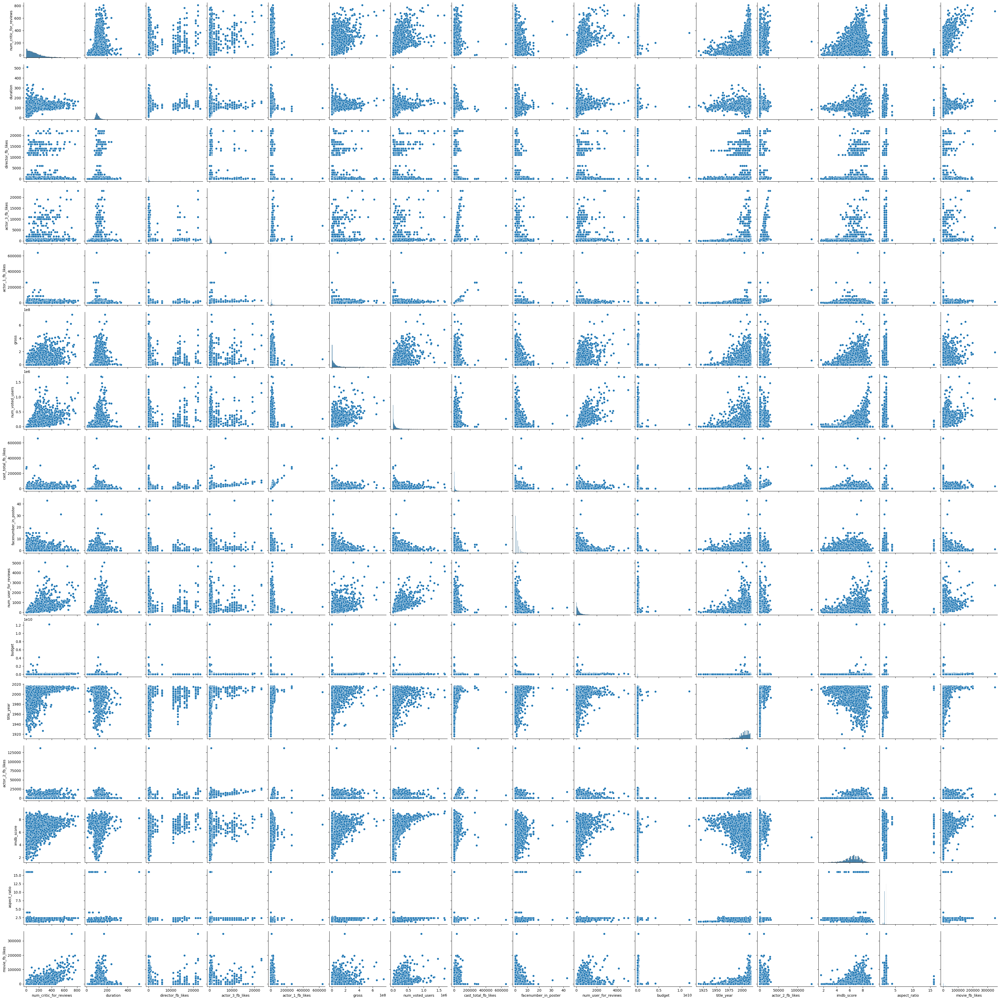

In [139]:
sns.pairplot(data=data)
plt.show()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

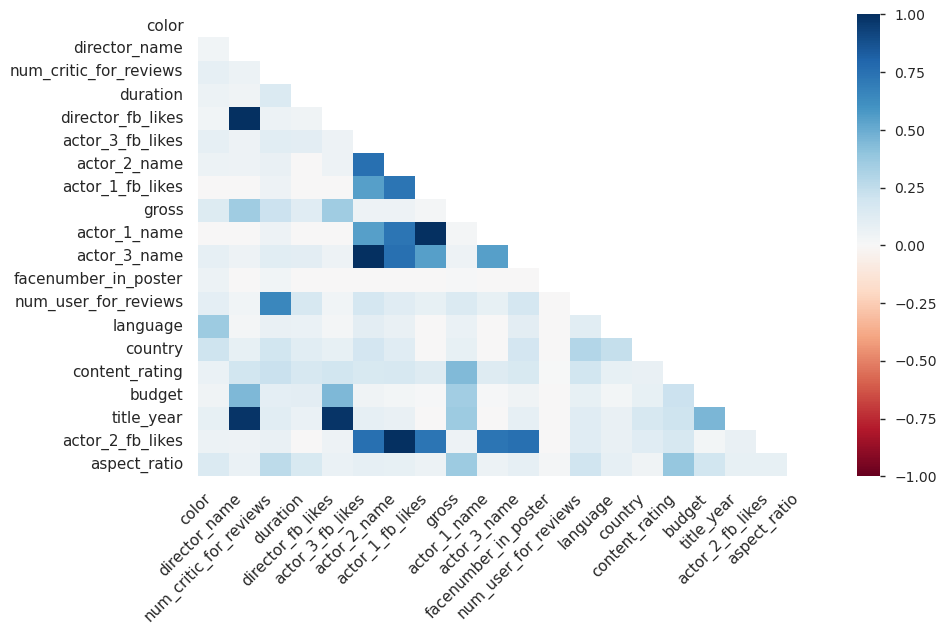

In [140]:
# Récapitulatif

profile = ProfileReport(data, title="Profiling Report")

profile

2. Prétraitement des données

In [143]:
# Traitement des valeurs manquantes par suppression des valeurs manquantes

data_cleaned = data.dropna()

In [144]:
data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3897 entries, 0 to 5042
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   color                   3897 non-null   object 
 1   director_name           3897 non-null   object 
 2   num_critic_for_reviews  3897 non-null   float64
 3   duration                3897 non-null   float64
 4   director_fb_likes       3897 non-null   float64
 5   actor_3_fb_likes        3897 non-null   float64
 6   actor_2_name            3897 non-null   object 
 7   actor_1_fb_likes        3897 non-null   float64
 8   gross                   3897 non-null   float64
 9   genres                  3897 non-null   object 
 10  actor_1_name            3897 non-null   object 
 11  movie_title             3897 non-null   object 
 12  num_voted_users         3897 non-null   int64  
 13  cast_total_fb_likes     3897 non-null   int64  
 14  actor_3_name            3897 non-null   objec

In [146]:
# Encodage des données

# Créer une copie des données
data_encoded = data_cleaned.copy()

# Sélectionner les colonnes catégorielles
categorical_columns = ['color', 'director_name', 'actor_2_name', 'genres', 'actor_1_name',
                       'movie_title', 'actor_3_name', 'language', 'country',
                       'content_rating']

# Encoder les valeurs catégorielles
label_encoder = LabelEncoder()
for col in categorical_columns:
    data_encoded[col] = label_encoder.fit_transform(data_encoded[col].astype(str))

# Vérifier les valeurs uniques après l'encodage
print(data_encoded.nunique())

color                        2
director_name             1768
num_critic_for_reviews     527
duration                   152
director_fb_likes          404
actor_3_fb_likes           890
actor_2_name              2320
actor_1_fb_likes           745
gross                     3873
genres                     779
actor_1_name              1530
movie_title               3896
num_voted_users           3844
cast_total_fb_likes       3401
actor_3_name              2754
facenumber_in_poster        19
num_user_for_reviews       950
language                    33
country                     48
content_rating              12
budget                     380
title_year                  75
actor_2_fb_likes           865
imdb_score                  74
aspect_ratio                18
movie_fb_likes             692
dtype: int64


In [147]:
# Colonnes à normaliser
columns_to_normalize = ['gross', 'budget', 'aspect_ratio']

# Colonnes à standardiser
columns_to_standardize = ['num_critic_for_reviews', 'duration', 'director_fb_likes', 'actor_3_fb_likes',
                          'actor_1_fb_likes', 'num_voted_users', 'cast_total_fb_likes', 'facenumber_in_poster',
                          'num_user_for_reviews', 'actor_2_fb_likes', 'imdb_score', 'movie_fb_likes']

# Copie de data_encoded pour la normalisation
data_normalized = data_encoded.copy()

# Normalisation des données
min_max_scaler = MinMaxScaler()
data_normalized[columns_to_normalize] = min_max_scaler.fit_transform(data_normalized[columns_to_normalize])

# Copie de data_encoded pour la standardisation
data_standardized = data_encoded.copy()

# Standardisation des colonnes non normalisées
standard_scaler = StandardScaler()
data_standardized[columns_to_standardize] = standard_scaler.fit_transform(data_standardized[columns_to_standardize])

# Supprimer les colonnes originales de data_encoded
data_encoded.drop(columns=columns_to_normalize + columns_to_standardize, inplace=True)

# Concaténation des données normalisées et standardisées avec data_encoded
data_combined = pd.concat([data_encoded, data_normalized[columns_to_normalize], data_standardized[columns_to_standardize]], axis=1)

In [148]:
data_combined.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3897 entries, 0 to 5042
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   color                   3897 non-null   int32  
 1   director_name           3897 non-null   int32  
 2   actor_2_name            3897 non-null   int32  
 3   genres                  3897 non-null   int32  
 4   actor_1_name            3897 non-null   int32  
 5   movie_title             3897 non-null   int32  
 6   actor_3_name            3897 non-null   int32  
 7   language                3897 non-null   int32  
 8   country                 3897 non-null   int32  
 9   content_rating          3897 non-null   int32  
 10  title_year              3897 non-null   float64
 11  gross                   3897 non-null   float64
 12  budget                  3897 non-null   float64
 13  aspect_ratio            3897 non-null   float64
 14  num_critic_for_reviews  3897 non-null   float

3. Entraînement de modèle : Régression linéaire

In [149]:
# Séparation des données en ensemble d'entraînement et ensemble de test
X = data_combined.drop(columns=['imdb_score'])
y = data_combined['imdb_score']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entraînement du modèle de régression linéaire
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Prédictions sur l'ensemble de test
y_pred_linear = linear_model.predict(X_test)

# Évaluation du modèle
mse_linear = mean_squared_error(y_test, y_pred_linear)
r2_linear = r2_score(y_test, y_pred_linear)

print("Régression linéaire - MSE:", mse_linear)
print("Régression linéaire - R2 Score:", r2_linear)


Régression linéaire - MSE: 0.6872662403513016
Régression linéaire - R2 Score: 0.3773236171739398


In [150]:
# Entraînement du modèle de forêt aléatoire
rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train)

# Prédictions sur l'ensemble de test
y_pred_rf = rf_model.predict(X_test)

# Évaluation du modèle
mse_rf = mean_squared_error(y_test, y_pred_rf)
r2_rf = r2_score(y_test, y_pred_rf)

print("Forêt aléatoire - MSE:", mse_rf)
print("Forêt aléatoire - R2 Score:", r2_rf)


Forêt aléatoire - MSE: 0.5090509921905088
Forêt aléatoire - R2 Score: 0.5387900468831712


In [151]:
# Amélioration Random Forest

# Random Forest - ajustement hyperparamètres

param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10]
}

rf_model = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(rf_model, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
best_rf_model = grid_search.best_estimator_

# Random Forext - Feature importance

feature_importances = best_rf_model.feature_importances_


In [152]:
# 1. Évaluation du modèle
mse = mean_squared_error(y_test, best_rf_model.predict(X_test))
r2 = r2_score(y_test, best_rf_model.predict(X_test))
print("Random Forest - MSE:", mse)
print("Random Forest - R2 Score:", r2)

# 2. Interprétation de l'importance des fonctionnalités
# Affichez les scores d'importance des fonctionnalités pour identifier les caractéristiques les plus importantes.
feature_importances = pd.DataFrame(best_rf_model.feature_importances_, index=X_train.columns, columns=["Importance"])
print("Feature Importances:\n", feature_importances)



Random Forest - MSE: 0.5090509921905088
Random Forest - R2 Score: 0.5387900468831712
Feature Importances:
                         Importance
color                     0.000384
director_name             0.027411
actor_2_name              0.022482
genres                    0.047211
actor_1_name              0.020603
movie_title               0.019014
actor_3_name              0.020993
language                  0.003007
country                   0.007397
content_rating            0.010884
title_year                0.030919
gross                     0.046913
budget                    0.102420
aspect_ratio              0.003628
num_critic_for_reviews    0.037311
duration                  0.107621
director_fb_likes         0.022660
actor_3_fb_likes          0.023854
actor_1_fb_likes          0.015586
num_voted_users           0.305114
cast_total_fb_likes       0.019204
facenumber_in_poster      0.013651
num_user_for_reviews      0.050146
actor_2_fb_likes          0.020910
movie_fb_likes    

In [153]:
# Supprimer les fonctionnalités avec une importance faible
low_importance_features = feature_importances[feature_importances['Importance'] < 0.01].index
X_train_filtered = X_train.drop(columns=low_importance_features)
X_test_filtered = X_test.drop(columns=low_importance_features)

# Réentrainer le modèle avec les fonctionnalités filtrées
grid_search_filtered = GridSearchCV(rf_model, param_grid, cv=10, scoring='neg_mean_squared_error')
grid_search_filtered.fit(X_train_filtered, y_train)

best_params_filtered = grid_search_filtered.best_params_
best_rf_model_filtered = grid_search_filtered.best_estimator_

# Évaluer le modèle filtré
mse_filtered = mean_squared_error(y_test, best_rf_model_filtered.predict(X_test_filtered))
r2_filtered = r2_score(y_test, best_rf_model_filtered.predict(X_test_filtered))
print("Random Forest (Fonctionnalités filtrées) - MSE:", mse_filtered)
print("Random Forest (Fonctionnalités filtrées) - R2 Score:", r2_filtered)

Random Forest (Fonctionnalités filtrées) - MSE: 0.5058863109281239
Random Forest (Fonctionnalités filtrées) - R2 Score: 0.5416573087470044


In [155]:
# Export du modèle :

joblib.dump(best_rf_model_filtered, 'imdb_model.pkl')

['imdb_model.pkl']